In [ ]:
## from bertviz import head_view
import torch
import pandas as pd
import random, numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from torch.utils.data import DataLoader
import torch.nn.functional as F 
from sklearn.model_selection import train_test_split
from tqdm.auto import tqdm

# Local imports
from test_without_path import test_MLM

# Variables
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# Models
# Trained on all reactions
path = "../CheckPoints/cp3_span_bpe.pkl"        # Dropout=0.2, Hidd_dim=256, Mask_prob=0.25 (span)

# Trained on USPTO only
#path = "../CheckPoints/cp2_uspto_span_bpe.pkl"        # Dropout=0.2; Hidd_dim=256; Mask_prob=0.3 (span)



In [ ]:
# Load data
df = pd.read_pickle("../Data/test_uspto_all_emb.pkl")          # Test set from USPTO dataset

# Load pre-tokenized reactions
load = torch.load("../Data/tokenized_uspto_data.pt")           # USPTO reactions

# Load test tensors
test_tensors = load["test"]

Testing...:   0%|          | 0/74 [00:00<?, ?it/s]

Test loss: 2.1518 | Perplexity: 8.6006 | MLM Accuracy: 0.5347 | Class Accuracy: 0.9863 

Visualizing Reaction #2242 (Label: DCC_condensation)

--------------------------------------------------
TOP-3 MECHANISM PREDICTIONS:
   DCC_condensation               : 100.00%
   primary_amide_dehydration      : 0.00%
   Weinreb_ketone_synthesis       : 0.00%
--------------------------------------------------

ANALYSIS: Attention map: #2242 reaction

 Original sequence:
[OH:101][C:1](=[O:2])[CH2:3][CH2:4][CH2:5][CH2:6][CH:7]([OH:8])[c:9]1[cH:10][cH:11][c:12](-[c:13]2[cH:14][cH:15][c:16]([Cl:17])[cH:18][cH:19]2)[cH:20][cH:21]1.[NH2:22][NH2:23].[N:301](=[C:302]=[N:303]C1CCCCC1)C2CCCCC2>>[C:1](=[O:2])([CH2:3][CH2:4][CH2:5][CH2:6][CH:7]([OH:8])[c:9]1[cH:10][cH:11][c:12](-[c:13]2[cH:14][cH:15][c:16]([Cl:17])[cH:18][cH:19]2)[cH:20][cH:21]1)[NH:22][NH2:23]

 Masked sequence:
[CLS][OH:101][C:1](=[O:2])[CH2:3][CH2:4][CH2:5][CH2:6][CH:7]([OH:8])[c:9]1[cH:10][cH:11][c:12](-[c:13]2[cH:14][cH:15][c:16]([Cl:17

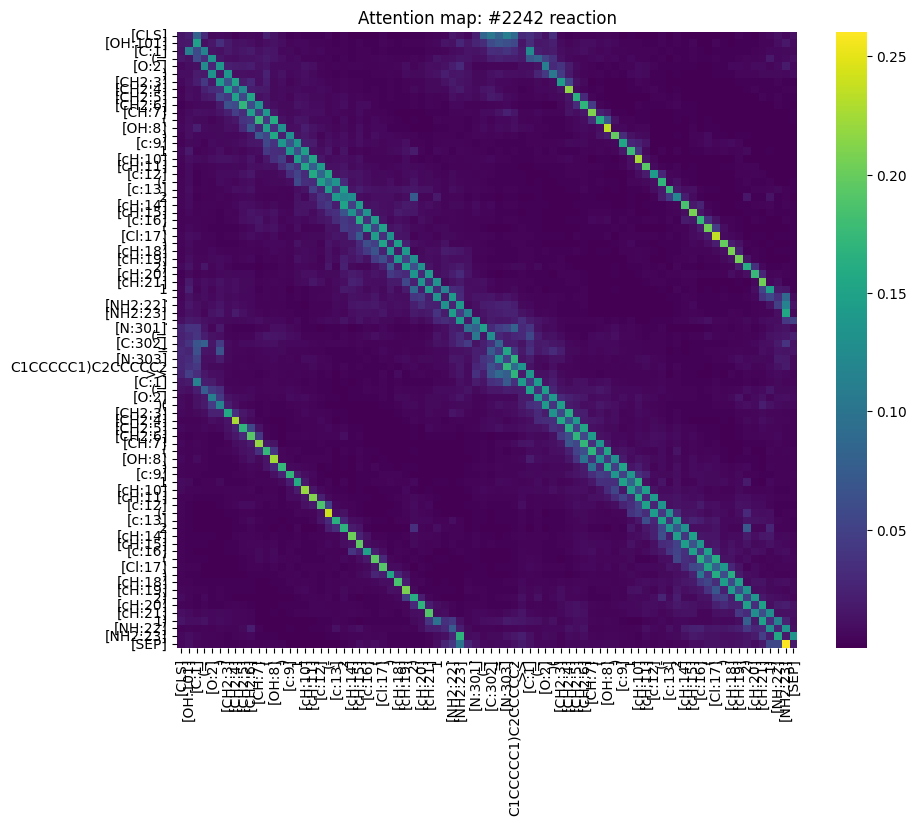

<IPython.core.display.Javascript object>


Visualizing Reaction #221 (Label: methyl_ester_synthesis)

--------------------------------------------------
TOP-3 MECHANISM PREDICTIONS:
   methyl_ester_synthesis         : 99.99%
   Staudinger                     : 0.01%
   aldol_addition                 : 0.00%
--------------------------------------------------

ANALYSIS: Attention map: #221 reaction

 Original sequence:
[CH3:1][CH2:2][CH2:3][CH2:4][CH2:5][CH:6]([OH:7])[CH2:8][CH2:9][CH2:10][C:11]([Cl:12])([CH2:13][CH2:14][CH2:15][CH2:16][CH2:17][CH2:18][C:19](=[O:20])[OH:21])[C:22]([CH3:23])=[O:24].[N-:201]=[N+:101]=[CH2:25]>>[CH3:1][CH2:2][CH2:3][CH2:4][CH2:5][CH:6]([OH:7])[CH2:8][CH2:9][CH2:10][C:11]([Cl:12])([CH2:13][CH2:14][CH2:15][CH2:16][CH2:17][CH2:18][C:19](=[O:20])[O:21][CH3:25])[C:22]([CH3:23])=[O:24]

 Masked sequence:
[CLS][CH3:1][CH2:2][CH2:3][CH2:4][CH2:5][CH:6]([OH:7])[CH2:8][CH2:9][CH2:10][C:11]([Cl:12])([CH2:13][CH2:14][CH2:15][CH2:16][CH2:17][CH2:18][C:19](=[O:20])[OH:21])[C:22]([CH3:23])=[O:24].[N-:201]=[N+:101

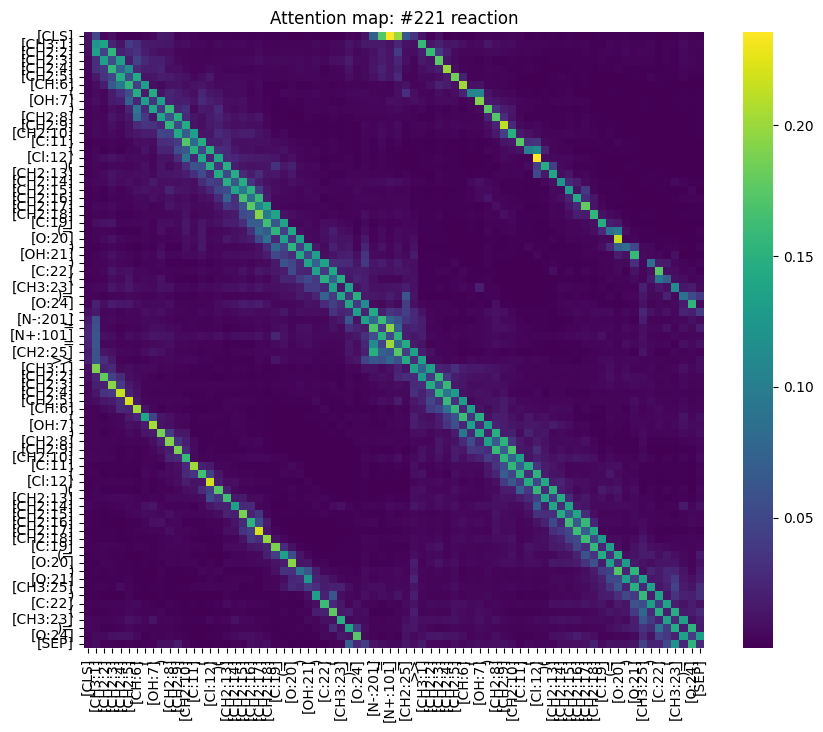

<IPython.core.display.Javascript object>


Visualizing Reaction #96 (Label: ester_reduction)

--------------------------------------------------
TOP-3 MECHANISM PREDICTIONS:
   ester_reduction                : 100.00%
   amide_reduction                : 0.00%
   Wolf_Kishner_reduction         : 0.00%
--------------------------------------------------

ANALYSIS: Attention map: #96 reaction

 Original sequence:
C[O:101][C:1](=[O:2])[C:3]1([c:4]2[cH:5][cH:6][cH:7][n:8][cH:9]2)[CH2:10][CH2:11]1.[AlH4-:301].[AlH4-:302].[H+:303]>>[CH2:1]([OH:2])[C:3]1([c:4]2[cH:5][cH:6][cH:7][n:8][cH:9]2)[CH2:10][CH2:11]1

 Masked sequence:
[CLS]C[O:101][C:1](=[O:2])[C:3]1([c:4]2[cH:5][cH:6][cH:7][n:8][cH:9]2)[CH2:10][CH2:11]1.[AlH4-:301].[AlH4-:302].[H+:303]>>(C2=CC=C(OC)C=C2)C2=CC=C([MASK][MASK][MASK][MASK][MASK][MASK]2[MASK][MASK][MASK][MASK]C1CCCCC1)C2CCCCC2[MASK][MASK][MASK][NH:36][SEP]

 Predicted sequence:
C[O:101][C:1](=[O:2])[C:3]1([c:4]2[cH:5][cH:6][cH:7][n:8][cH:9]2)[CH2:10][CH2:11]1.[AlH4-:301].[AlH4-:302].[H+:303].[CH2:1]([OH:2])[C:3]1(

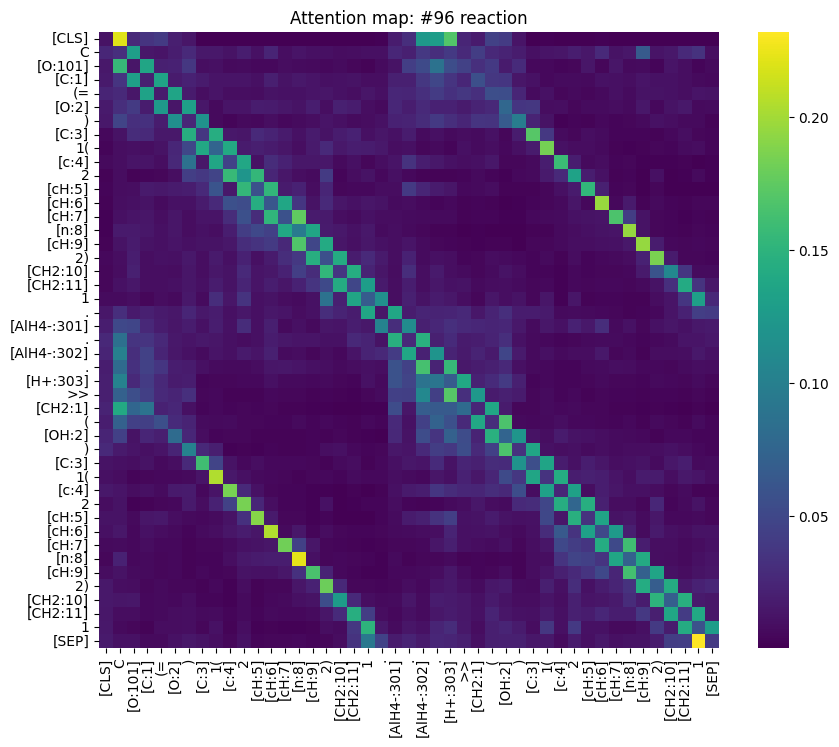

<IPython.core.display.Javascript object>

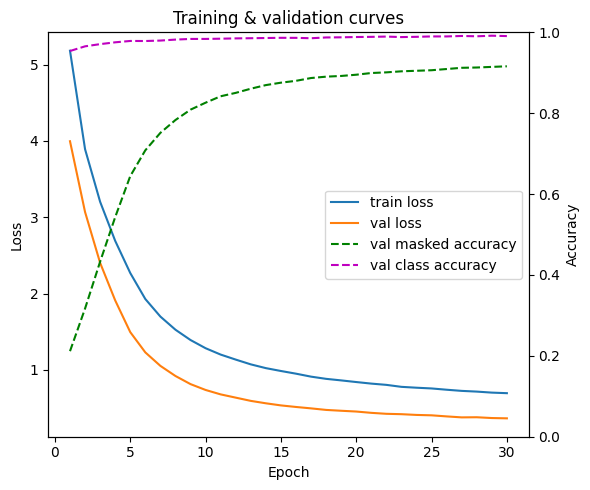


CLASS-WISE REPORT
                                                    precision    recall  f1-score   support

                   (hemi)acetal(aminal)_hydrolysis       1.00      1.00      1.00        20
                                             Appel       1.00      1.00      1.00        10
                                  Boc_deprotection       1.00      1.00      1.00       286
                                  Cbz_deprotection       1.00      1.00      1.00        39
                                  DCC_condensation       1.00      1.00      1.00       869
                                 Fmoc_deprotection       1.00      1.00      1.00         4
                          Friedel_Crafts_acylation       1.00      1.00      1.00        18
                                          Grignard       0.97      1.00      0.98        28
                       Hantzsch_thiazole_synthesis       1.00      1.00      1.00        24
                           Horner_Wadsworth_Emmons       1.0

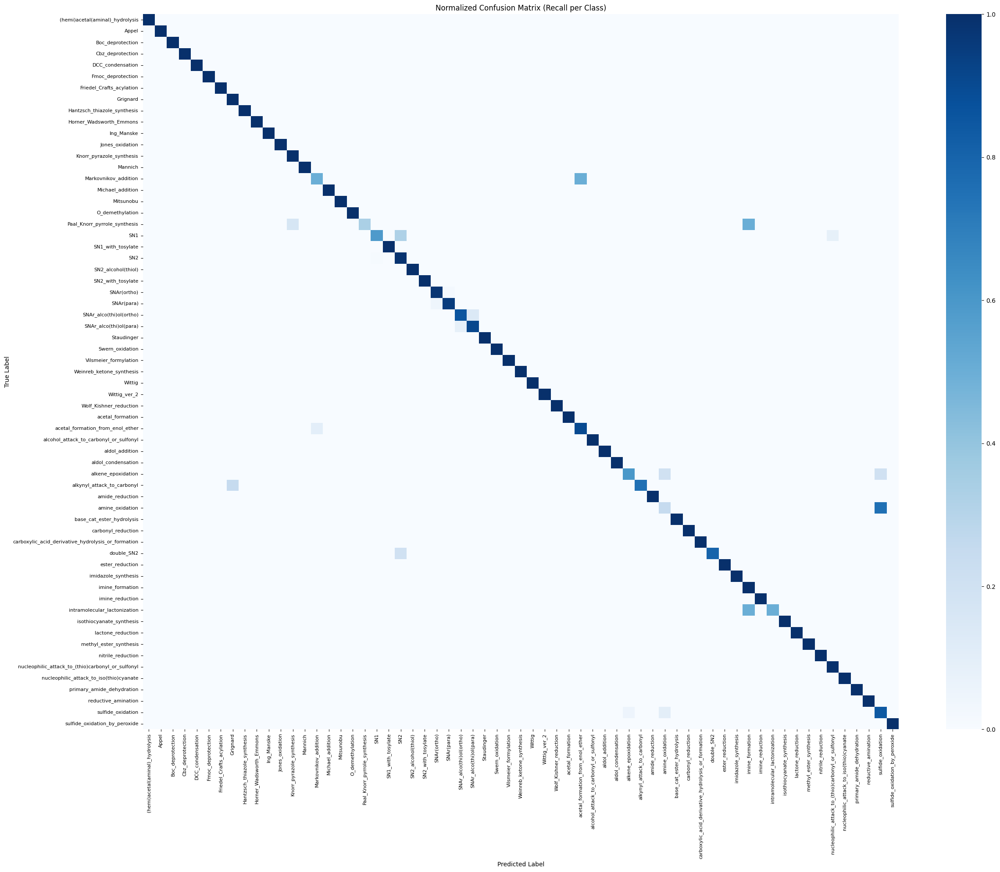


TOP SYSTEMATIC ERRORS
True Class                                         | Predicted As                                       | Count
---------------------------------------------------------------------------------------------------------
SN1                                                | SN2                                                | 15
SN2                                                | SN1                                                | 6
amine_oxidation                                    | sulfide_oxidation                                  | 6
SN1                                                | nucleophilic_attack_to_(thio)carbonyl_or_sulfonyl  | 4
SNAr(para)                                         | SNAr(ortho)                                        | 4
SNAr_alco(thi)ol(ortho)                            | SNAr_alco(thi)ol(para)                             | 4
SNAr_alco(thi)ol(para)                             | SNAr_alco(thi)ol(ortho)                            | 4
Pa

In [3]:
%matplotlib inline
# Print reports and attention map plots for 3 reactions
short = False    # Shorter version of report
seed = 12
mode = "full_product_mask"           # "basic", "full_product_mask"
mask_prob = 0.3
result = test_MLM(load=True, path=path, test_tensors=test_tensors, test_df=df, mode=mode, mask_prob=mask_prob, short=short, seed=seed)
